# Анализ рынка заведений общественного питания в Москве

Презентация: https://cloud.mail.ru/public/KV2A/hHM6zVx2u

Перед нами задача подготовить аналитику для инвесторов, которые решили открыть заведение общепита в Москве. В нашем распоряжении данные из открытых источников о кафе и ресторанах города с местоположением, рейтингом, типом заведения и средним чеком. Проверим, насколько корректные данные в датасете, избавимся от дубликатов и попробуем заполнить пропуски. Добавим дополнительные столбцы, которые облегчат анализ и построим графики, чтобы исследовать количество заведений, их распределение по округам, ценовую категори и пользовательский рейтинг. Построим графики на основании ключевых наблюдений. Сделаем визуализацию, которая поможет предпринимателям принять правильное решение о том, какое заведение открывать, где оно должно находиться и какую ценовую политику иметь.

## Загрузка библиотек и исходных данных

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
import re
import numpy as np
from plotly import graph_objects as go
import json
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon
import warnings
warnings.filterwarnings('ignore')

pd.options.display.max_colwidth = 120

sns.set(rc={'figure.figsize':(12,6)})

Теперь загрузим исходные данные.

In [2]:
try:
    data = pd.read_csv('moscow_places.csv')
except:
    data = pd.read_csv('/datasets/moscow_places.csv')

try:
    state_geo = 'admin_level_geomap.geojson'
except:
    state_geo = '/datasets/admin_level_geomap.geojson'    
    
with open(state_geo, encoding='utf-8') as f:
    gj = json.load(f)

## Предобработка данных

В процессе предобработки посмотрим, есть ли в данных дубликаты и насколько корректно заполнены поля. При необходимости, внесем исправления или удалим часть данных.

In [3]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Перед нами датасет на 8406 строк, в таблице есть пропуски в столбцах с рабочими часами, уровнем цен, средним чеком и средней ценой чашки кофе. Также не везде указано количество посадочных мест. Информация о рабочих часах указана в текстовом формате, в таком виде ее трудно анализировать. 
<br>
<br> Посмотрим на распределение числовых данных 

In [5]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
lat,8406.0,55.750109,0.069658,55.573942,55.705155,55.753425,55.795041,55.928943
lng,8406.0,37.608570,0.098597,37.355651,37.538583,37.605246,37.664792,37.874466
rating,8406.0,4.229895,0.470348,1.000000,4.100000,4.300000,4.400000,5.000000
middle_avg_bill,3149.0,958.053668,1009.732845,0.000000,375.000000,750.000000,1250.000000,35000.000000
middle_coffee_cup,535.0,174.721495,88.951103,60.000000,124.500000,169.000000,225.000000,1568.000000
chain,8406.0,0.381275,0.485729,0.000000,0.000000,0.000000,1.000000,1.000000
seats,4795.0,108.421689,122.833396,0.000000,40.000000,75.000000,140.000000,1288.000000


Менее 25% заведений имеют оценку ниже, чем 4.1. То есть пользователи ставят низкие оценки нечасто. Максимальный средний чек больше результатат первой квартили почти в 10 раз, а также существует заведение, где чашка кофе стоит 1568 рублей (стоит убедиться, что это не ошибка и не аномалия). Медианное значение посадочных мест для московского кафе - 75, но существует заведение, куда уместятся 1288 посетителей. 
<br>
<br> Необходимо проверить данные на наличие дубликатов и аномалий. Для начала проверим, есть ли в данных полные дубликаты

In [6]:
data.duplicated().sum()

0

Полных дубликатов нет. Теперь посморим внимательнее на содержимое каждого столбца. Проверим, есть ли дублированные названия среди заведений, не являющихся сетевыми.

In [7]:
same_name_not_chain = data.loc[(data['name'].duplicated()==True) & (data['chain']==0)]
same_name_not_chain_names = data.loc[(data['name'].duplicated()==True) & (data['chain']==0)]['name'].unique()

display(same_name_not_chain)
display(same_name_not_chain_names)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
47,Кафе,кафе,"Москва, улица Маршала Федоренко, 7",Северный административный округ,"ежедневно, 11:00–00:00",55.880306,37.489760,2.8,NaN,NaN,NaN,NaN,0,35.0
108,Кафе,"бар,паб","Москва, МКАД, 82-й километр, вл18",Северо-Восточный административный округ,NaN,55.908930,37.558777,4.2,NaN,NaN,NaN,NaN,0,NaN
123,Кафе,кафе,"Москва, Шенкурский проезд, 14",Северо-Восточный административный округ,NaN,55.897794,37.591395,4.3,NaN,NaN,NaN,NaN,0,50.0
141,Кафе,кафе,"Москва, Дубнинская улица, 52, стр. 1",Северный административный округ,"ежедневно, 10:00–20:00",55.896020,37.556072,3.9,NaN,NaN,NaN,NaN,0,70.0
159,Кафе,кафе,"Москва, Дмитровское шоссе, 163А",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.908830,37.538790,4.0,NaN,NaN,NaN,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7931,Кафе,кафе,"Москва, Каширское шоссе, 67А",Южный административный округ,NaN,55.596680,37.725980,4.0,NaN,NaN,NaN,NaN,0,NaN
7938,Кафе,кафе,"Москва, улица Генерала Белова, 28, корп. 1",Южный административный округ,NaN,55.604990,37.724762,4.5,NaN,NaN,NaN,NaN,0,NaN
7945,Кафе,кафе,"Москва, МКАД, 19-й километр, вл20с1",Южный административный округ,NaN,55.621773,37.781727,4.0,NaN,NaN,NaN,NaN,0,NaN
7976,Кафе,кафе,"Москва, МКАД, 19-й километр, вл12с1",Южный административный округ,NaN,55.616980,37.779312,4.3,NaN,NaN,NaN,NaN,0,NaN


array(['Кафе', 'Шаурма', 'Ресторан', 'Столовая', 'Кафе-столовая', 'Буфет',
       'Кофейня', 'Бистро', 'Шашлычная', 'Пиццерия', 'Блины', 'Трапезная',
       'Поминальные обеды', 'Кафе для поминок', 'Чебуречная',
       'Кафе-кулинария'], dtype=object)

349 заведений с общими названиями, про которые почти нет информации о среднем чеке и количестве посадочных мест. Возможно, это очень простые локальные заведения, которые не стремятся к уникальности, а работают на небольшую категорию клиентов (поминальные церемонии, доставка пиццы в спальном микрорайоне или продажа чебуреков у метро). Полагаю, эти заведения не являются конкурентами или ориентирами для наших инвесторов, поэтому мы можем удалить их из выборки.

In [8]:
data = data.loc[~((data['name'].duplicated()==True) & (data['chain']==0))]

Посмотрим, какие типы общепита представлены в нашей базе

In [9]:
data.category.unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

Неявных дубликатов нет, в этом столбце доработки не требуются.
<br>
<br> Посмотрим, есть ли заведения, в адресе которых не указан город Москва

In [10]:
data.loc[~data['address'].str.contains('Москва')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Таких заведений нет. 
<br> Для удобства создадим столбец, в котором будет указана только улица. 
<br> В общем виде нам подойдет паттерн между "Москва," и следующей запятой, но есть также заведения на МКАДе, где название улицы (МКАД) отделено от номера км запятой. Уберем запятую между названием улицы и номером км, чтобы сохранить эти данные в столбце с улицами.

In [11]:
data['address'] = data['address'].replace({'МКАД,':'МКАД'}, regex=True)
data['street'] = data['address'].apply(lambda x: re.search('[^Москва,][А-яё0-9 -]+', x).group())
data['street']

0                  улица Дыбенко
1                  улица Дыбенко
2             Клязьминская улица
3        улица Маршала Федоренко
4            Правобережная улица
                  ...           
8401           Профсоюзная улица
8402       Пролетарский проспект
8403            Люблинская улица
8404            Люблинская улица
8405         Россошанский проезд
Name: street, Length: 8057, dtype: object

Проверим, есть ли неявные дубликаты в столбце с названиями округов

In [12]:
data.district.unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

Ошибок и неявных дубликатов нет. Судя по всему, наши данные не содержат информации о заведениях в Новой Москве.
Добавим столбец с сокращенными названиями округов, чтобы информация о них занимала меньше места в таблицах и на графиках

In [13]:
data['district_short'] = data['district'].replace(
    {
        'Северный административный округ':'САО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Восточный административный округ':'СВАО',
        'Северо-Западный административный округ':'СЗАО',
        'Центральный административный округ':'ЦАО',
        'Восточный административный округ':'ВАО',
        'Западный административный округ':'ЗАО',
        'Южный административный округ':'ЮАО'
    }
    , regex=True)

Теперь посмотрим внимательнее на часы работы заведений

In [14]:
display(data['hours'].unique())
display(data['hours'].nunique())

array(['ежедневно, 10:00–22:00',
       'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
       'ежедневно, 09:00–22:00', ...,
       'пн-пт 08:30–21:30; сб,вс 09:00–21:30',
       'пн-чт 13:00–22:00; пт,сб 13:00–22:30; вс 13:00–22:00',
       'пн-сб 10:30–21:30'], dtype=object)

1282

1282 варианта графиков работы ресторанов! Поскольку проанализировать все виды графика работ невозможно, нас будут интересовать только те кафе, которые работают 24/7. Добавим столбец для этого признака.

In [15]:
data['hours'][data['hours'].str.contains('ежедневно') & data['hours'].str.contains('круглосуточно')].unique()

array(['ежедневно, круглосуточно'], dtype=object)

In [16]:
data['is_24/7'] = data['hours'].str.contains('ежедневно, круглосуточно')

Посмотрим на данные о широте и долготе

In [17]:
data[['lat','lng']].describe().T

,count,mean,std,min,25%,50%,75%,max
lat,8057.0,55.750305,0.069099,55.575511,55.706255,55.753832,55.794665,55.928943
lng,8057.0,37.608315,0.097288,37.355651,37.539253,37.605081,37.663388,37.874466


Изменения по обоим параметрам в пределах от минимума до максимум 0.5 градуса. Будем считать, что данные корректны. Посмотрим на рейтинг.

In [18]:
data['rating'].describe().T

count    8057.000000
mean        4.240909
std         0.463011
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

Медианное значение для рейтинга - 4.3. Только 25% заведений имеют среднюю оценку ниже 4.1.
<br> Данные об уровне цен доступны для менее чем половины ресторанов в выборке. Посмотрим, можно ли заполнить какие-то пропуски.

In [19]:
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

Заполним пропуски в столбцах с уровнем цен, средним чеком, и стоимостью средней чашки кофе на основании данных о заведениях с тем же названием из базы при условии, что в заполненных данных есть только один вариант. Напишем формулу, чтобы заполнить несколько столбцов

In [20]:
def fill_empty(val):
    # выделим названия ресторанов, где нет данных о об уровне цен
    no_price = data['name'][data[val].isna()].unique()
    # выберем из базы все рестораны с такими названиями (в т.ч. с информацией о ценах)
    data_no_price = data[data['name'].isin(no_price)]
    # выберем только те сети, где указан один вариант 
    data_no_price_pivot = data_no_price.pivot_table(index=['name'], values=val, aggfunc='nunique').reset_index()
    list_to_fill = data_no_price_pivot['name'][data_no_price_pivot[val] == 1]
    # создадим справочник, на основании которого будем заполнять пустые строки
    b = data[data['name'].isin(list_to_fill)]
    a = b.pivot_table(index=['name',val], values='district', aggfunc='count').reset_index()
    # заполним пустые строки для тех ресторанов, у которых в базе есть еще заведения с тем же названием и указан уровень цен
    for row in a.index:
        data.loc[(data['name'] == a['name'][row]) & (data[val].isna()), val] = a[val][row]

In [21]:
fill_empty('price')
fill_empty('avg_bill')
fill_empty('middle_avg_bill')
fill_empty('middle_coffee_cup')

Полагаю, что цена чашки капучино задумывался, как показатель уровня цен для кофейни, но здесь мы видим, что и у других заведений тоже есть такой параметр. Думаю, заведения, у которых вместо среднего чека информация о цене чашки кофе, лучше перенести в категорию кофейня. 

In [22]:
data.loc[(data['avg_bill'].str.contains('Цена чашки капучино:')) & (data['category'] != 'кофейня'), 'category'] = 'кофейня'

Теперь посмотрим, как коррелируют данные об уровне цен и размер среднего чека

In [23]:
data.pivot_table(index='middle_avg_bill', columns='price', values=['district'], aggfunc='count').reset_index()

middle_avg_bill district                             
price                  высокие выше среднего низкие средние
0                 0.0      1.0           NaN    NaN     NaN
1                90.0      NaN           NaN    1.0     NaN
2               100.0      NaN           NaN    6.0     1.0
3               107.0      NaN           NaN    1.0     NaN
4               120.0      NaN           NaN    6.0     NaN
..                ...      ...           ...    ...     ...
208            6500.0      1.0           NaN    NaN     NaN
209            7000.0      2.0           NaN    NaN     NaN
210            7250.0      1.0           NaN    NaN     NaN
211           10000.0      1.0           NaN    NaN     NaN
212           11000.0      1.0           NaN    NaN     NaN

[213 rows x 5 columns]

Уровень цен не всегда одинаково коррелирует со средним чеком - иногда рестораны с одним и тем же средним чеком попадают в разные категории. Возможно, это как-то связано с типом заведения или размером заказов. Если есть возмножность, лучше уточнить, как именно рассчитывается средний счет. В данной задаче оставим эту связь без корректировок, но будем иметь ввиду, что данные не всегда связаны одинаково.
<br>  Посмотрим на цены чашки капучино, которые привлекли наше внимание при первоначальной оценке данных

In [24]:
data[data['middle_coffee_cup']>500]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,district_short,is_24/7
2859,Шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,1,48.0,Большая Семёновская улица,ВАО,False


Очевидно, это ошибка, и в столбец avg_bill вместо 290 внесли сумму 2907. Средним между 230 и 290 является 260, эту сумму и напишем вместо ужасающих 1568 (и это в Шоколаднице!)

In [25]:
data.loc[data['middle_coffee_cup']>500, 'middle_coffee_cup'] = 260

### Вывод
Предобработав данные, мы удалили небольшое количество строк с данными о несетевых локальных заведениях, которые не представляют для нас интереса, добавили столбцы с улицами и отметкой о том, что ресторан является круглосуточным, заполнили некоторое количество пропусков в данных об уровне цен и среднем чеке. Стоит отметить, что в данных нет общего подхода к определению категории цены относительно размера среднего чека, поэтому заведения с одинаковыми ценами могут попадать в разные категории.

## Анализ данных

### Обзор основных параметров

Для того, чтобы подробнее изучить датасет, посмотрим на данные в разрезе разных параметров. Изучим, сколько заведений относятся к разным категориям и ценовым сегментам, как они распределяются географически и какие рейтинги ставят посетители разным местам.
<br>
<br> Посмотрим, как распределены заведения общепита по категории.

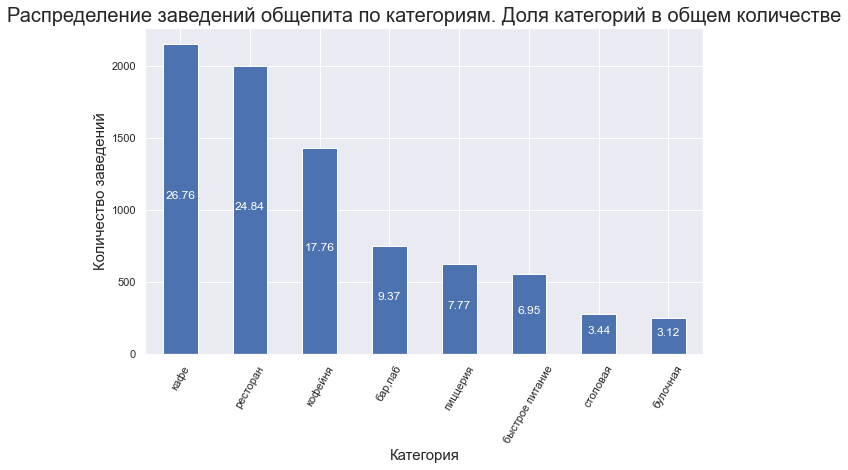

In [26]:
df = (data
      .pivot_table(index='category', values='name', aggfunc='count')
      .sort_values(by='name', ascending=False)
      .reset_index()
      )

df['share'] = round(df['name']*100/df['name'].sum() , 2)


def addlabels(category, name, share):
    for i in range(len(category)):
        plt.text(i,name[i]/2,share[i],ha='center', color='white')
        
ax = (data
      .pivot_table(index='category', values='name', aggfunc='count')
      .sort_values(by='name', ascending=False)
      .plot(kind='bar', figsize=(10, 6))
     )

addlabels(df['category'], df['name'], df['share'])
plt.title('Распределение заведений общепита по категориям. Доля категорий в общем количестве', fontsize = 20)
plt.xlabel('Категория', fontsize = 15)
plt.ylabel('Количество заведений', fontsize = 15)
plt.xticks(rotation=60 )
ax.legend_ = None
plt.show()

Самые популярные категории заведений - кафе, ресторан и кофейня. На них приходится почти 70% общепита Москвы.
<br> Посмотрим, как распределены заведения в зависимости от количества посадочных мест.

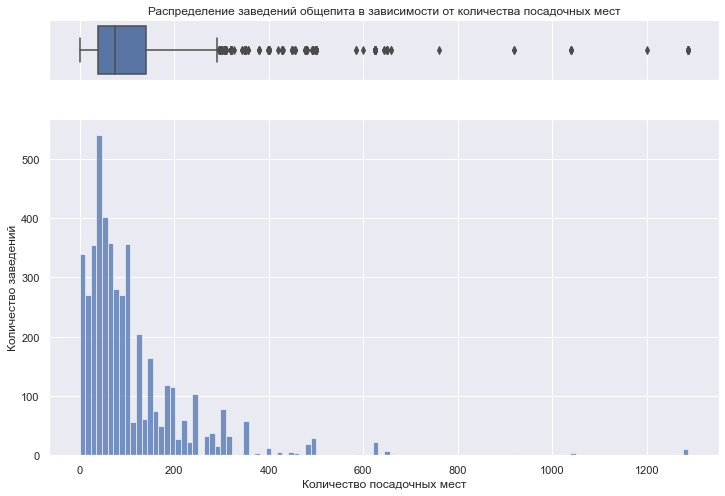

In [27]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(data['seats'], ax=ax_box)
sns.histplot(data=data, x='seats', ax=ax_hist)
ax_box.set(xlabel='', title='Распределение заведений общепита в зависимости от количества посадочных мест')
ax_hist.set(xlabel='Количество посадочных мест', ylabel='Количество заведений')
plt.show()

Самая значительная часть заведений в выборке находится в диапазоне 50 - 150 посадочных мест. Заведения, где больше 500 мест встречаются крайне редко, но есть и те, где уместятся более 1000 человек.
<br> Посмотрим как распределены заведения в зависимости от того, являются ли они сетевыми.

In [28]:
data_chain = pd.DataFrame(data.chain.value_counts().reset_index())
labels = data_chain['chain']

fig = go.Figure(data=[go.Pie(labels=data_chain['index'], values=data_chain['chain'])])
fig.update_layout(title='Доля сетевых заведений в общепите Москвы',
                  width=800,
                  height=600,
                  annotations=[dict(x=1.5,
                                    y=1.5,
                                    text='Категория',
                                    showarrow=False)])
fig.show() 

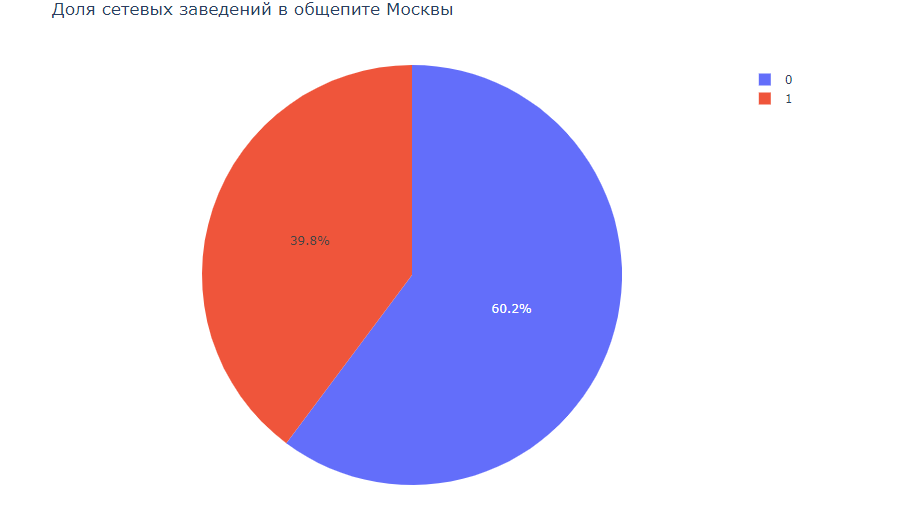

60% заведений в Москве являются несетевыми. Посмотрим, как данные распределяются в зависимости от категории заведения.

In [29]:
df = (data.pivot_table(index=['category','chain'], values='name', aggfunc='count')
      .reset_index()
     )
df['chain'] = df['chain'].replace({0 :'not_chain', 1 : 'chain'})

fig = px.bar(df, y='category', x='name', color='chain', text='name')

fig.update_layout(yaxis={'categoryorder':'total ascending'},
                 title='Сетевые и несетевые заведения Москвы по категориям',
                 xaxis_title='Категория',
                 yaxis_title='Количество точек',
                 legend_title='')
fig.show()

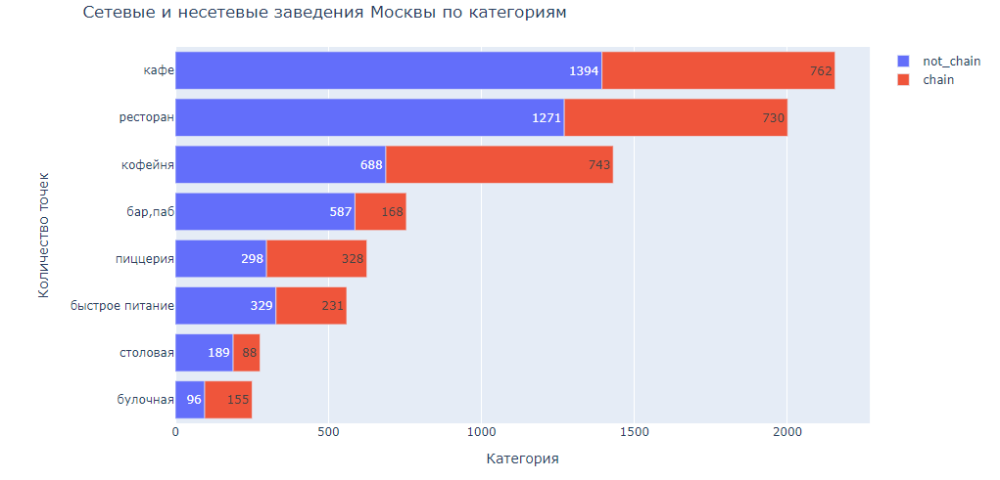

Наибольшая доля сетевых заведений общепита наблюдается среди булочных, пиццерий и фастфуда. Наименьшая доля - среди баров и пабов. Кофейни делятся на сетевые и единичные примерно поровну, кафе и рестораны примерно на треть состоят из сетевых заведений.

### Основные особенности топ-15 самых крупных сетей Москвы

Посмотрим, какие заведения относятся к топ-15 самых крупных сетей в городе, к каким категориям они относятся и в каких округах представлены.

In [30]:
df = (data
      .pivot_table(index='name', values='category', aggfunc='count')
      .sort_values(by='category', ascending=False)
      .reset_index()
      .head(15)
     ) 

data['top_15'] = data['name'].isin(df['name'])
top_15 = data[data['top_15']==True]
# Переименуем братьев Караваевых, чтобы они занимали поменьше места на графиках
top_15['name'] = top_15['name'].replace({'Кулинарная лавка братьев Караваевых':'Караваевы'}, regex=True)

df = (top_15
      .pivot_table(index='name', values='category', aggfunc='count')
      .sort_values(by='category', ascending=False)
      .reset_index()
     )  

In [31]:
fig = px.bar(df.sort_values(by='category'), x='category', y='name', text='category')

fig.update_layout(title='Топ-15 сетей Москвы',
                   xaxis_title='Количество точек',
                   yaxis_title='Название сети')
fig.show()

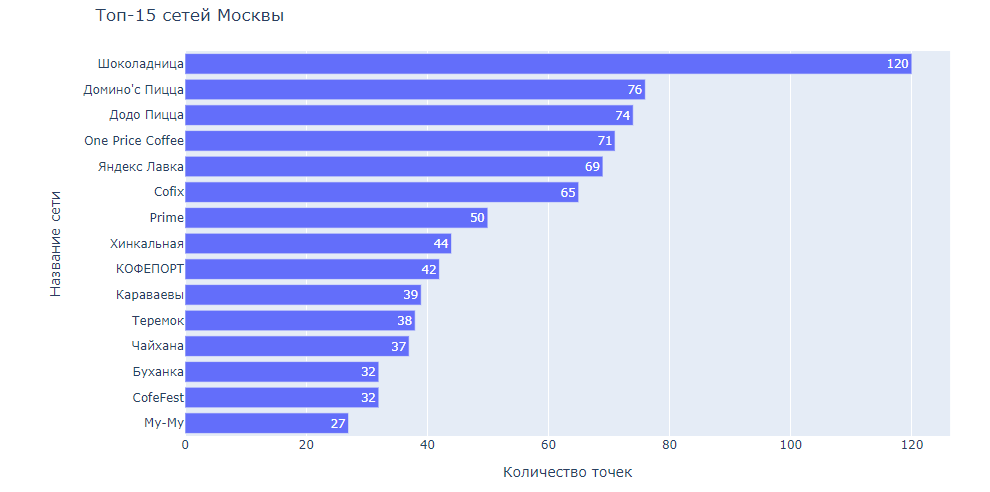

Среди самых больших сетей представленных в Москве, много кофеен, пиццерии, фастфуд и заведения, нацеленные на офисные обеды, а еще представители восточной кухни. Значительная часть этих заведений обязана своим успехом пандемии и умению быстро и качественно доставлять еду домой или в офис. Вторая часть популярных сетей - это кофейни с возможностью взять кофе с собой. Посмотрим, какие категории преобладают среди самых крупных сетевых заведений.

In [32]:
df = (top_15
      .pivot_table(index=['category'], values='address', aggfunc='count')
      .sort_values(by='address', ascending=False)
      .reset_index()
     ) 

fig = px.bar(df.sort_values(by='address'), x='address', y='category', text='address')

fig.update_layout(title='Топ-15 сетей Москвы по категориям',
                   xaxis_title='Количество точек',
                   yaxis_title='Категория')
fig.show()

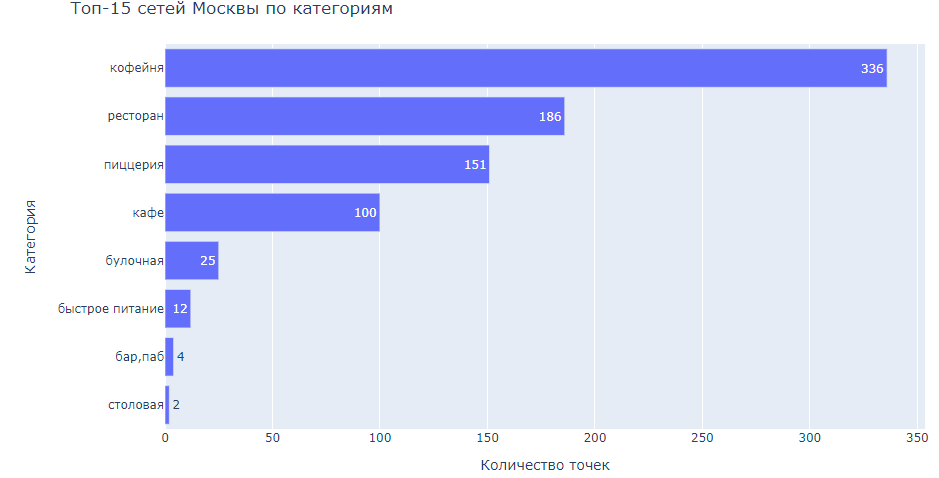

В разрезе категорий кофейни занимают практически половину точек из топ-15 популярных сетей. Значительное количество точек относятся к категорям "ресторан" и "пиццерия". Лишь небольшое количество заведений отмечены, как "быстрое питение", "бар,паб" или "столовая". Возможно,  это связано с размытостью терминов - что одному кажется столовой, для другого вполне себе ресторан. 
<br> Посмотрим, как точки из топ-15 распределяются по районам города.

In [33]:
df = (top_15
      .pivot_table(index=['district_short'], values='address', aggfunc='count')
      .sort_values(by='address', ascending=False)
      .reset_index()
     ) 

fig = px.bar(df.sort_values(by='address'), x='address', y='district_short', text='address')

fig.update_layout(title='Топ-15 сетей Москвы по округам',
                  xaxis_title='Количество точек',
                  yaxis_title='Округ'
                 )
fig.show()

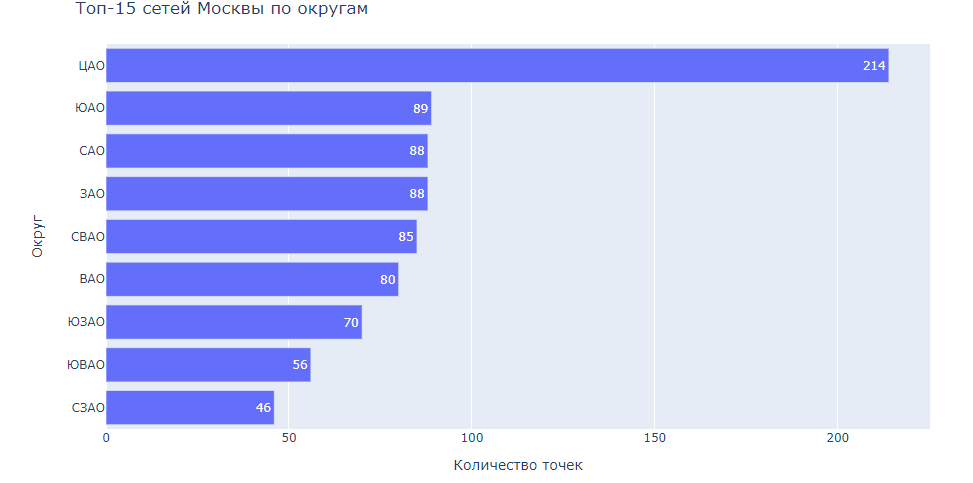

Больше всего заведений сосредоточено в Центральном округе. Меньше всего - в ЮВАО и СЗАО.  В остальных округах популярные заведения распределены приблизительно равномерно.

In [34]:
df = (top_15
      .pivot_table(index=['name', 'district_short'], values='address', aggfunc='count')
      .sort_values(by='address', ascending=False)
      .reset_index()
     ) 

fig = px.bar(df.sort_values(by='address'), x='address', y='name', color='district_short', text='address')

fig.update_layout(title='Топ-15 сетей Москвы по округам',
                  xaxis_title='Количество точек',
                  yaxis_title='Название'
                 )
fig.show()

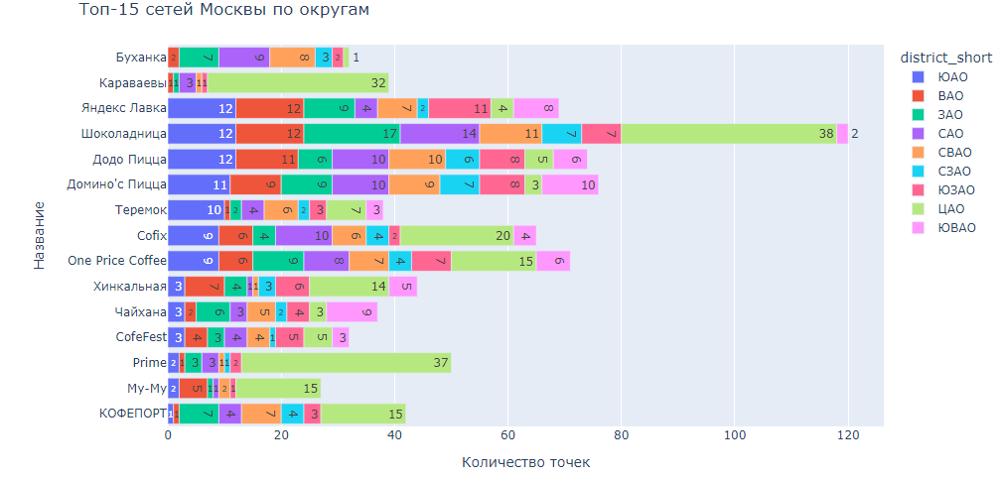

Заведения всех сетей из Топ-15 представлены в ЦАО. Также можно обратить внимание, что некоторые сети почти не представлены в других районах, кроме ЦАО. Можем предположить, что это сети высокого ценового диапазона, и они не окупаются в спальных районах. Посмотрим на данные в разрезе округ - категория.

In [35]:
df = (top_15
      .pivot_table(index=['category', 'district_short'], values='address', aggfunc='count')
      .sort_values(by='address', ascending=False)
      .reset_index()
     ) 

fig = px.bar(df.sort_values(by='address'), x='address', y='category', color='district_short', text='address')

fig.update_layout(title='Топ-15 сетей Москвы по категориям и округам',
                  xaxis_title='Количество точек',
                  yaxis_title='Категория'
                 )
fig.show()

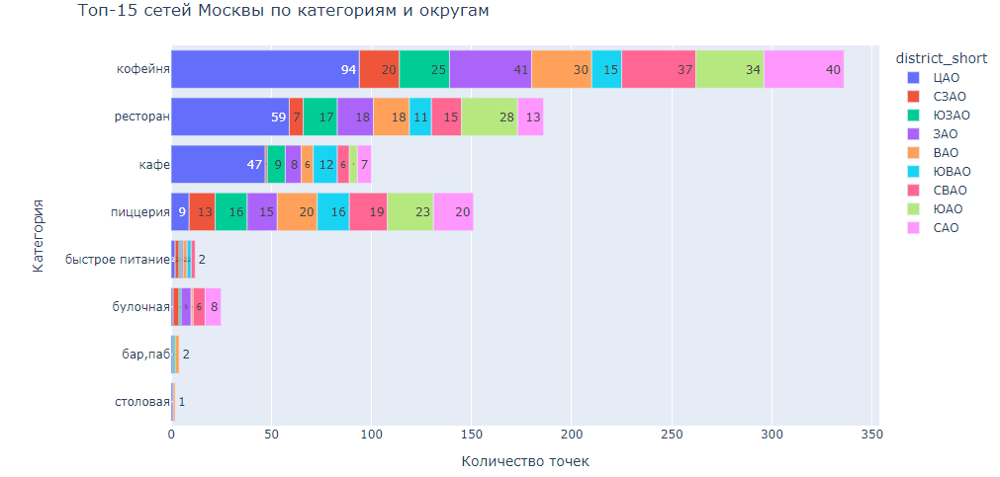

Среди заведений сетей из Топ-15 Кофеен, ресторанов и кафе больше всего в ЦАО, а вот пиццерий в других округах больше, чем в центре.

### Обзор основных характеристик заведений общепита

Посмотрим на всю выборку с точки зрения изменения различных характеристик в зависимости от округа и категории. Для начала посмотрим, как меняется доля заведений разной категории от округа к округу.

In [36]:
df = data.groupby(['district_short', 'category'])['name'].agg('count').reset_index().sort_values(by='name', ascending=False)
percent = (data.groupby(['district_short', 'category'])
           .size().groupby(level=0)
           .apply(lambda x: round(100 * x / float(x.sum()), 2))
           .reset_index()
           .rename(columns={0: 'percentage'}))
df = pd.merge(df, percent, how='left', on=['district_short', 'category'])

fig = px.bar(
    percent, 
    x='district_short', 
    y='percentage', 
    text='percentage', 
    color='category', 
    title='Распределение количества заведений по районам',
    width=1000,
    height=1200
    ) 
fig.update_layout(
    title='Типы заведений по районам (в процентах)',
    xaxis_title="Район",
    yaxis_title="Количество",
    xaxis=dict(
        tickmode='array',
        tickvals=percent['district_short'],
        ticktext=percent['district_short']
    ),
    legend_title=''
)

fig.show()

В ЦАО наблюдается самая больша доля баров и меньшая относительно других районов доля пиццерий, заведений быстрого питания и булочных. Самая большая доля пиццерий в СЗАО, а кофеен - в САО.

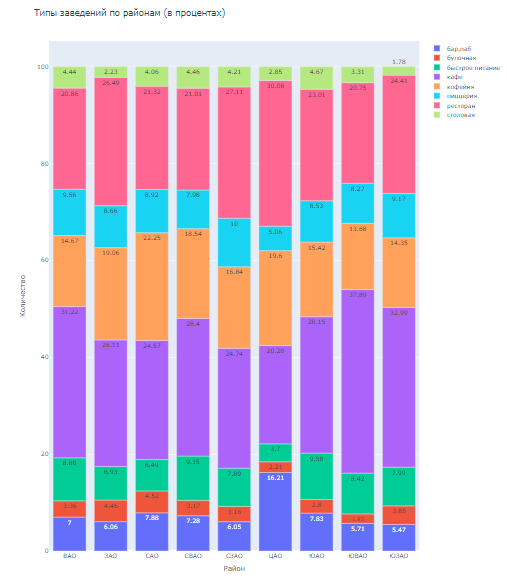

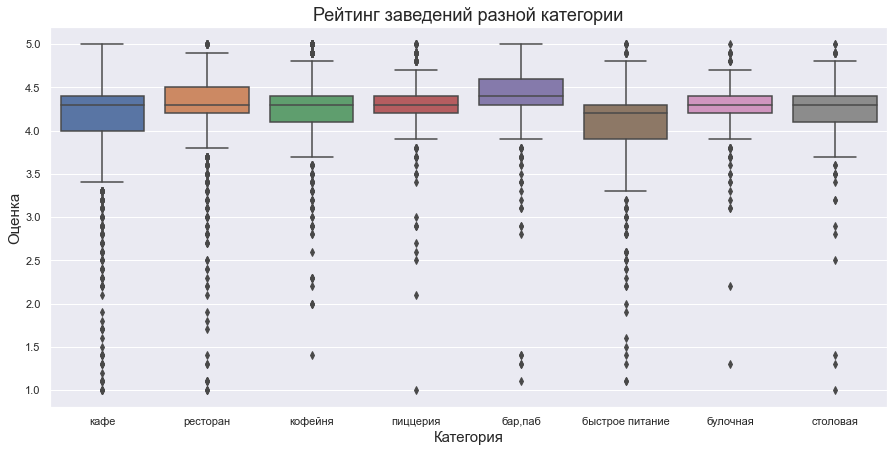

In [37]:
fig, boxplot = plt.subplots(figsize = (15,7))
sns.boxplot(x='category', y='rating', data=data)
plt.title('Рейтинг заведений разной категории', fontsize=18)
plt.xlabel('Категория', fontsize=15)
plt.ylabel("Оценка", fontsize=15)
plt.show()

Наиболее благосклонны посетители к барам (ожидаемо), самый низкий средний рейтинг у заведений быстрого питания. 
<br> Видно, что заведения всех категорий получают очень низкие оценки, больше всех - кафе, рестораны и заведения быстрого питания. По графику видно, что люди не склонны ставить средние оценки. Они готовы поставить 4 и выше, если им все понравилось и ставят единицы, если их что-то не устроило. Разрыв между минимальными оценками и остальной выборкой есть у кофеен, пиццерий, баров, булочных и столовых.
<br> Посмотрим на рейтинги в разбивке по округам Москвы

In [38]:
rating_df = data.groupby('district', as_index=False)['rating'].agg('median')

moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=gj,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

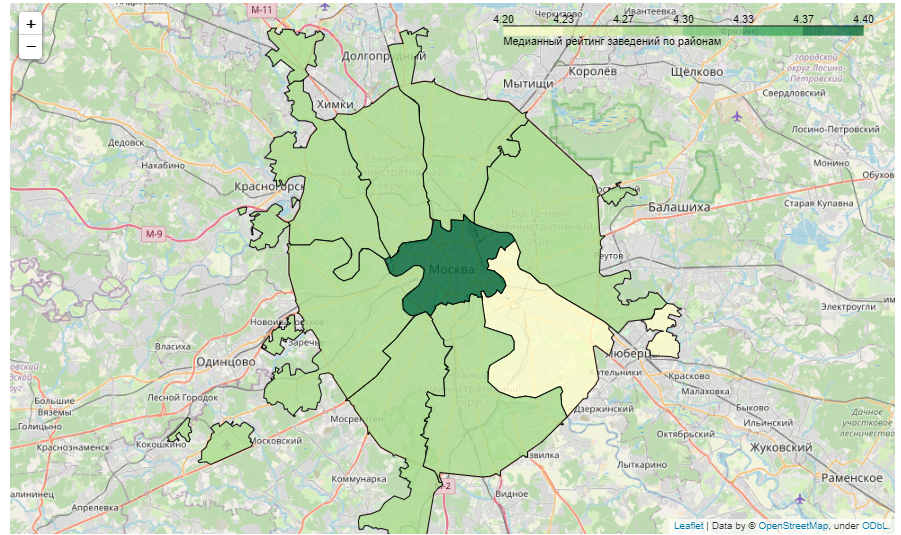

Самые высокий медианный рейтинг у заведений в центральном округе, ниже всего пользователи оценивают общепит в ЮВАО. Посмотрим на общее количество заведений.

In [39]:
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

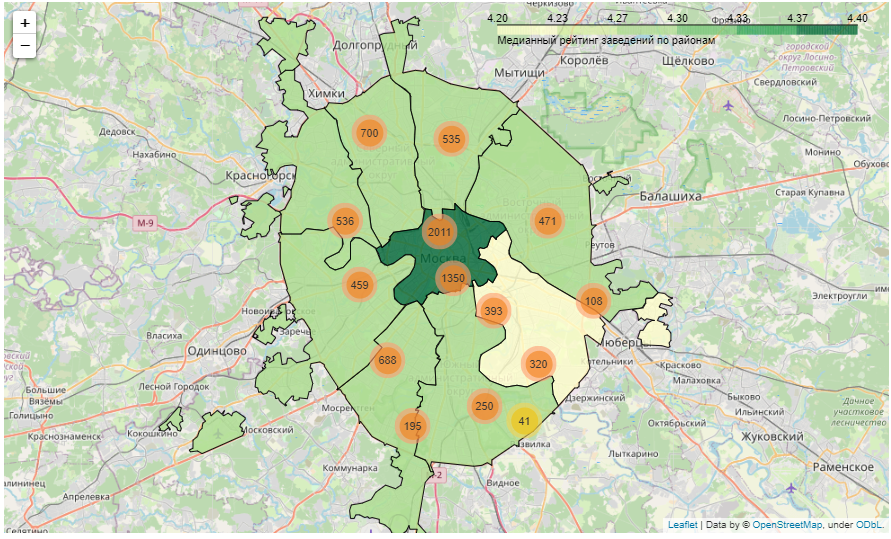

На карте видно, что в центральном округе заведений на порядок больше, чем в любом другом округе Москвы. Не удивительно - ведь центр города это центр притяжения людей. Здесь рабочие места, развлечения, красивые локации для прогулок. Также здесь живут самые обеспеченные горожане, готовые ходить в рестораны не только по особым поводам, но и просто поесть. Посмотрим, какие улицы самые популярные у рестораторов.

### Обзор Топ-15 улиц Москвы по количеству заведений общепита

In [40]:
top_str = (data
           .pivot_table(index='street', values='name', aggfunc='count')
           .reset_index()
           .sort_values(by='name', ascending=False)
           .head(15)
          )

data['top_str'] = data['street'].isin(top_str['street'])
df_top_str = data[data['top_str']==True]

df = (df_top_str
      .pivot_table(index=['street','category'], values='name', aggfunc='count')
      .sort_values(by='name', ascending=False)
      .reset_index()
     ) 

fig = px.bar(df.sort_values(by='name'), x='name', y='street', color='category', text='name')

fig.update_layout(title='Топ-15 улиц Москвы по кличеству ресторанов по категориям',
                  xaxis_title='Количество точек',
                  yaxis_title='Название улицы',
                  legend_title=''
                 )
fig.show()

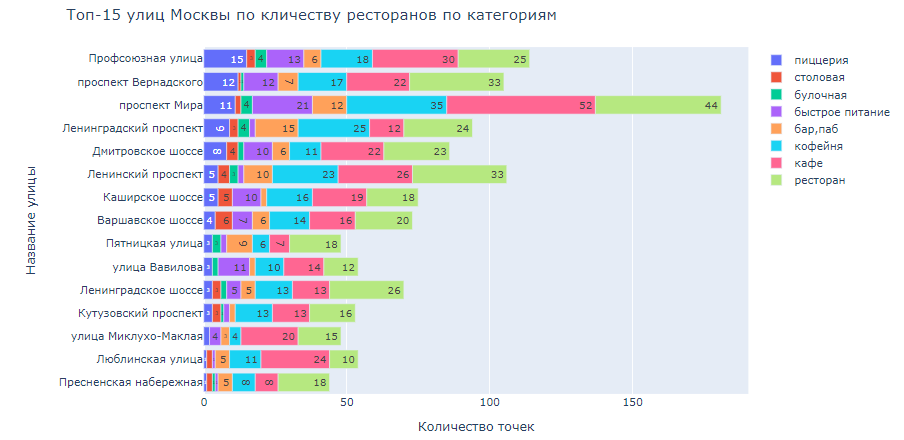

В топ вошли только две улицы центрального округа - Пятницкая и Пресненская набережная (последняя не без помощи Москва-сити, где много офисов и ресторанов). Остальные улицы - это ключевые магистрали города, и оказались они в списке не из-за того, что там располагаются привлекательные локации, а просто это самые длинные улицы города, вот и ресторанов на них умещается много. Значительная часть заведений на улицах-чемпионах - кафе, рестораны и кофейни (что коррелирует с распределением по городу в целом).
<br> Теперь посмотрим на улицы, где расположен только один объект общепита.

### Обзор единственных заведений на улице 

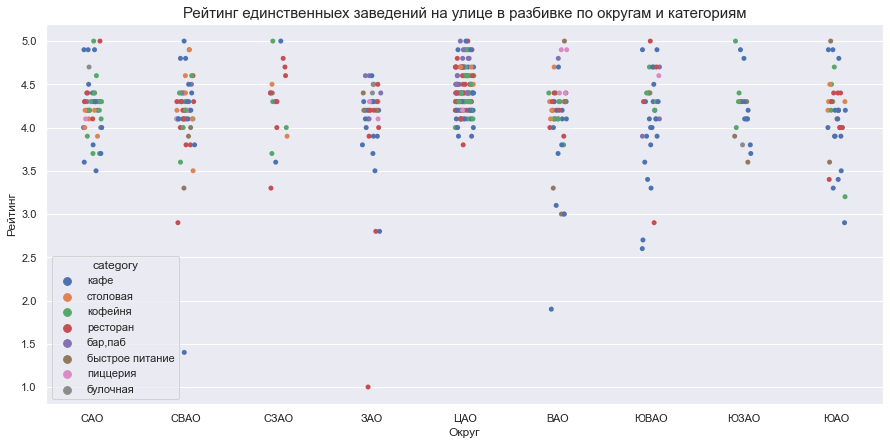

In [41]:
one_cafe_str = data.pivot_table(index='street', values='name', aggfunc='count').reset_index()
one_cafe_str = one_cafe_str[one_cafe_str['name']==1]
data['one_cafe_str'] = data['street'].isin(one_cafe_str['street'])
data_one_cafe_str = data[data['one_cafe_str']==True]

fig, boxplot = plt.subplots(figsize = (15,7))
sns.stripplot(x='district_short', y='rating', data=data_one_cafe_str, hue='category')
plt.title('Рейтинг единственныех заведений на улице в разбивке по округам и категориям', fontsize=15)
plt.xlabel('Округ')
plt.ylabel("Рейтинг")
plt.show()

Подобных заведений достаточно в каждом округе, больше всего их наблюдается в ЦАО, меньше всего - в СЗАО. Примечательно, что в ЗАО у таких заведений рейтинг ниже, чем в других округах - есть даже один ресторан, получивший единицу. Представлены заведения разных категорий, больше всего - кафе.
<br> Теперь посмотрим, как распределение по округам вляет на средний чек.

### Влияние округа на средний чек

In [42]:
avg_bill_df = data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')

moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=gj,
    data=avg_bill_df,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный средний чек заведений по округам'
).add_to(m)

# выводим карту
m

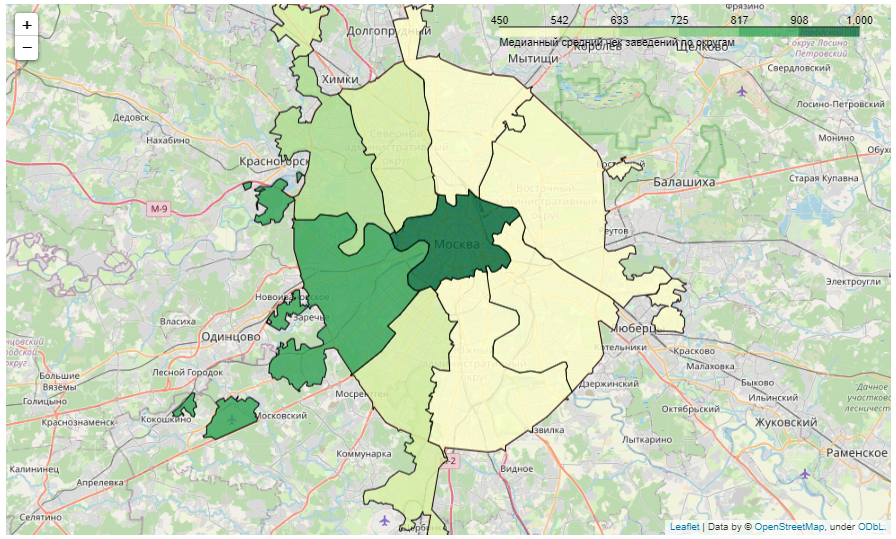

Самый высокий средний чек, предсказуемо, в центре, на втором месте ЗАО, а дальше округа, находящиеся рядом с ЗАО. ЗАО - это Кутузовский проспект и Рублевка, место концентрации богачей. Поэтому и цены тут высокие. Восточная часть города в отношении цен в ресторанах дешевле западной. То есть, цена среднего чека не всегда коррелирует с отдаленностью от центра.
<br> Теперь посмотрим на заведения с низким рейтингом - какие категории получают его чаще других и какой там уровень цен.

### Заведения с низким рейтингом

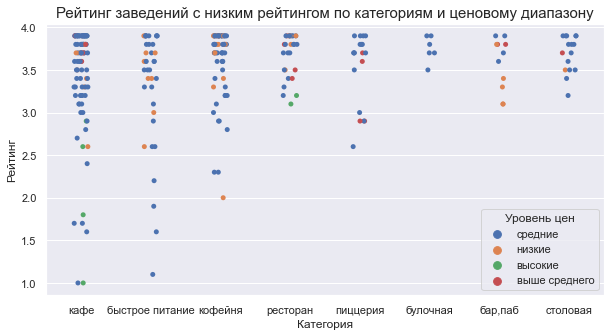

In [43]:
data_low_rating = data[data['rating']<4]

fig, boxplot = plt.subplots(figsize = (10,5))
sns.stripplot(x='category', y='rating', data=data_low_rating, hue='price')
plt.title('Рейтинг заведений с низким рейтингом по категориям и ценовому диапазону', fontsize=15)
plt.xlabel('Категория')
plt.ylabel("Рейтинг")
plt.legend(title='Уровень цен')
plt.show()

Заведениями с рейтингом ниже 4 чаще всего оказываются кафе, фастфуд и кофейни. Эти категории заведений также получают оценки ниже 2.5, чего с другими категорями не происходит. Диапазон цен чаще всего средний. Примечательно, что есть кафе с высокими ценами, получившее единицу. Среди баров наименьшие оценки получают заведения из дешевого сегмента.

### Подведем итоги
- Наибольшая часть заведений Москвы - это кафе, рестораны и кофейни
- Около 40% заведений являются сетевыми
- Обычно в заведении 50-150 посадочных мест, но встречаются места, где больше 1000
- В топ-15 сетевых заведений Москвы входят кофейни, пиццерии, заведения с домашней едой и фастфуд
- Больше всего заведений находится в ЦАО, в других округах количество примерно одинаковое
- Самый высокий средний рейтинг у пабов, самый низкий - у заведений быстрого питания
- В разбивке по округам самый низакий рейтинг у заведений в ЮВАО, самый высокий - в ЦАО
- Наибольшее количество точек питания находятся на магистральных улицах города, также в топ попали Пятницкая и Пресненская набережная
- В восточной части города средний чек ниже, чем в западной. Самый высокий средний чек в центре.
- Среди заведений с низким рейтингом преобладают кафе со средним уровнем цен

## Открытие кофейни

Поскольку было принято решение открывать кофейню, посмотрим внимательнее на эту категорию заведений общепита. Посмотрим, сколько всего кофеен в нашей выборке и как они распределены по округам

In [44]:
df_coffee = data[data['category']=='кофейня']

In [45]:
df = (df_coffee
      .pivot_table(index=['district_short', 'chain'], values='address', aggfunc='count')
      .sort_values(by='address', ascending=False)
      .reset_index()
     ) 
df['chain'] = df['chain'].replace({0 :'not_chain', 1 : 'chain'})

fig = px.bar(df.sort_values(by='address'), x='address', y='district_short', color='chain', text='address')

fig.update_layout(title='Кофейни Москвы в по округам',
                  xaxis_title='Количество точек',
                  yaxis_title='Округ',
                  legend_title=''
                 )
fig.show()

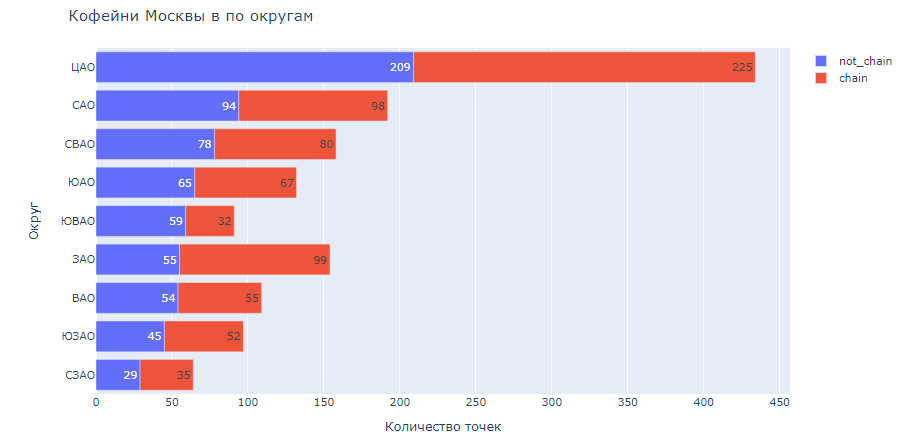

Больше всего кофеен в центре города - в любом другом округе минимум в 2 раза меньше точек. Меньше всего кофеен в ЮЗАО, ЮВАО и СЗАО. ЮВАО - единственный округ, где несетевых кофеен больше, чем сетевых.
<br> Посмотрим, какая часть кофеен работает круглосуточно.

In [46]:
data_24 = pd.DataFrame(df_coffee['is_24/7'].value_counts().reset_index())
labels = data_24['is_24/7']

fig = go.Figure(data=[go.Pie(labels=data_24['index'], values=data_24['is_24/7'])])
fig.update_layout(title='Доля круглосуточных заведений среди кофеен Москвы',
                  width=800,
                  height=600,
                  annotations=[dict(x=1.5,
                                    y=1.5,
                                    text='Категория',
                                    showarrow=False)])
fig.show() 

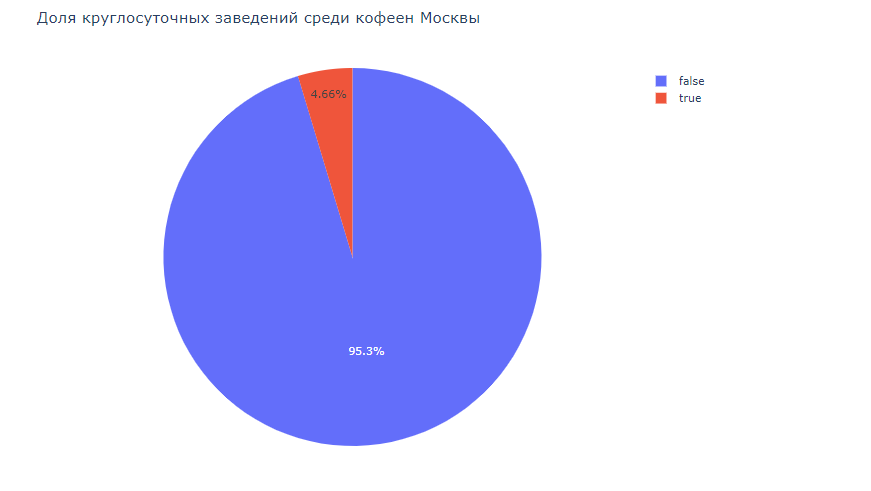

Менее 5% заведений работают круглосуточно. В основном это заведения на заправках, рядом с вокзалами и в местах с активной ночной жизнью. Посмотрим на рейтинги кофеен.

In [47]:
rating_df = df_coffee.groupby('district', as_index=False)['rating'].agg('median')

moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=gj,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг кофеен по округам',
).add_to(m)

# выводим карту
m

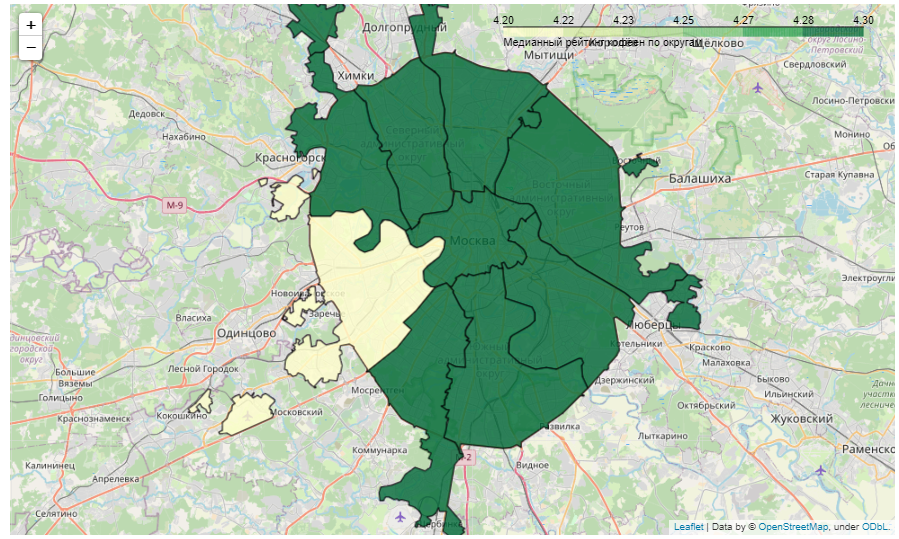

Медианный рейтинг от округа к округу отличается незначительно - в пределах 10 процентных пунктов. Но удивительно, что самый низкий рейтинг в ЗАО. Возможно, клиенты там более требовательны, чем в других округах.

In [48]:
rating_df = df_coffee.groupby('district', as_index=False)['middle_coffee_cup'].agg('median')

moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=gj,
    data=rating_df,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианная цена чашки капучино по округам',
).add_to(m)

# выводим карту
m

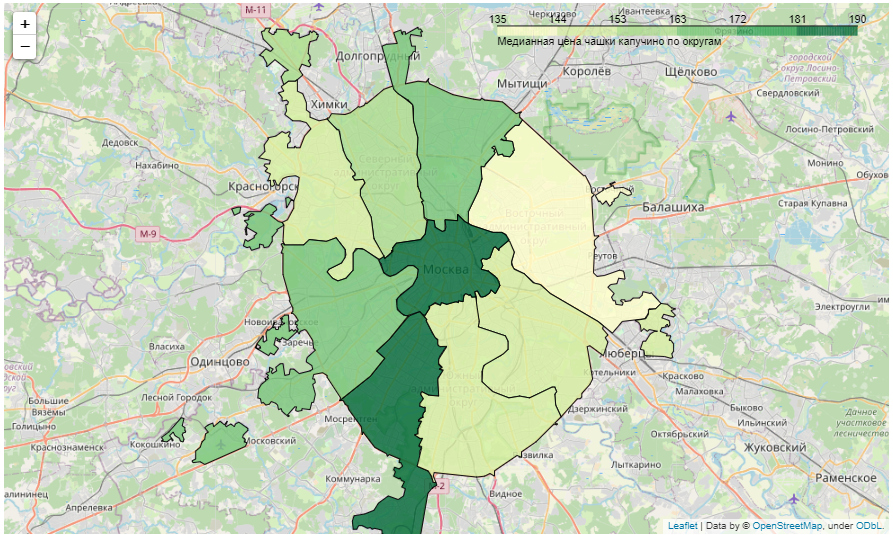

Самая высокая цена чашки капучино в ЮЗАО и ЦАО, самые низкие цены в ВАО. Полагаю, в ВАО представлены заведения дешевого ценового сегмента, а дорогих заведений меньше, чем в других округах.

### Выводы и предложения

Проанализировав кофейни отдельно от других заведений, можно сделать следующие выводы:
- Самое большое количество кофеен находится в ЦАО, меньше всего - СЗАО. Разделение на сетевые и единичные примерно поровну.
- Менее 5% кофеен работают круглосуточно.
- Медианный рейтинг кофеен в разных округах варьируется несильно, но ниже всего он в ЗАО.
- Медианная цена цашки кофе выше всего в ЦАО и ЮЗАО, ниже всего в ВАО.

In [49]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
park_lat, park_lng = 55.793212, 37.673232

# считываем данные из файла
df = df_coffee

# создаём карту Москвы
p = Map(location=[park_lat, park_lng], zoom_start=15.5)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(p)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/windows/512/espresso-cup.png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
p

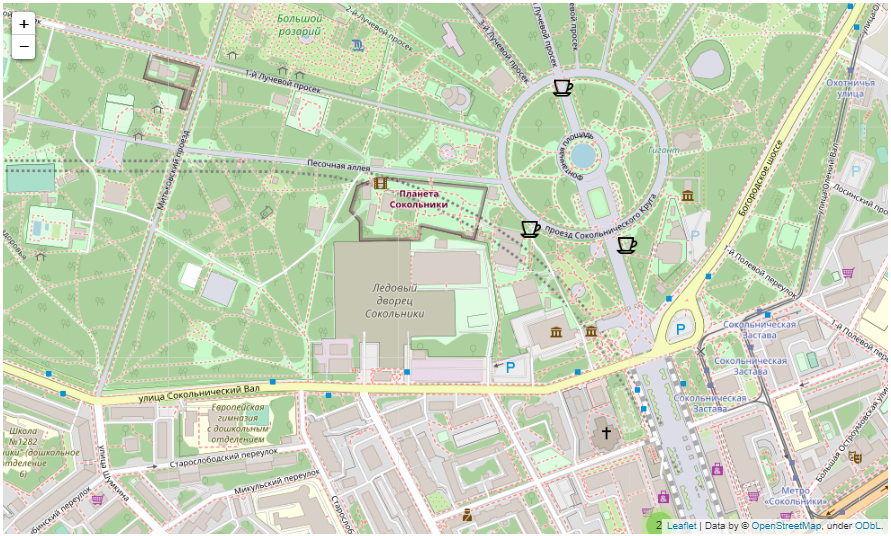

Для открытия кофейни лучше выбрать восточную часть города, так как там ниже аренда и менее притязательная публика. На большой округ ВАО приходится чуть больше 100 кофеен - это в 1,5 раза меньше, чем в ЗАО и в 4 раза меньше, чем в центре. 
<br> Хорошей локацией выглядит парк Сокольники, тогда можно будет выдержать идею кофейни рядом с парком. Можно также рассмотреть места не в самом парке, тогда заведение будет привлекательно и для офисных работников. 
<br> Цену чашки капучино нужно выдержать в пределах 150 руб, чтобы быть конкурентными среди уже существующих заведений. Как альтернативу, можно рассмотреть открытие кофейни ценовой категории "выше среднего" и привлечь более взыскательную публику, которой раньше здесь было некуда пойти.
<br> Количество посадочных мест лучше ограничить 50 - люди, пришедшие выпить кофе рядом с парком, вряд ли заходят сидеть в огромном шумном заведении. К тому же, многие клиенты захотят взять кофе с собой.
<br> График работы нужно распланировать таким образом, чтобы кофейня была открыта с 8 в будние дни, когда люди идут на работу и могут купить себе кофе и завтрак по пути. В выходные можно открываться позже и работать подольше (например, с 10 до 22), чтобы порадовать больше гуляющих.